# WLASL Dataset Demo

Applying an Inception 3D pre-trained/fine-tuned model to a single video from the WLASL dataset.
- Original repo: https://github.com/dxli94/WLASL

All the folder references are from the original repo!

## Dataset

From `code/I3D/datasets/nslt_dataset_all.py`

In [1]:
import json
import os
import os.path

import cv2
import numpy as np
import torch
import torch.utils.data as data_utl


def video_to_tensor(pic):
    """Convert a ``numpy.ndarray`` to tensor.
    Converts a numpy.ndarray (T x H x W x C)
    to a torch.FloatTensor of shape (C x T x H x W)
    
    Args:
         pic (numpy.ndarray): Video to be converted to tensor.
    Returns:
         Tensor: Converted video.
    """
    return torch.from_numpy(pic.transpose([3, 0, 1, 2]))


def load_rgb_frames_from_video_dataset(video_path, start=0, num=-1):
    # video_path = os.path.join(vid_root, vid + '.mp4')

    vidcap = cv2.VideoCapture(video_path)
    # vidcap = cv2.VideoCapture('/home/dxli/Desktop/dm_256.mp4')

    frames = []
    if num == -1:
        num = int(vidcap.get(cv2.CAP_PROP_FRAME_COUNT))

    vidcap.set(cv2.CAP_PROP_POS_FRAMES, start)
    for offset in range(num):
        success, img = vidcap.read()

        w, h, c = img.shape
        if w < 226 or h < 226:
            d = 226. - min(w, h)
            sc = 1 + d / min(w, h)
            img = cv2.resize(img, dsize=(0, 0), fx=sc, fy=sc)
        img = (img / 255.) * 2 - 1

        frames.append(img)

    return np.asarray(frames, dtype=np.float32)

    
class SingleVideoNSLTDataset(data_utl.Dataset):

    def __init__(self, video_tensor, label, start_frame, num_frames, video_name, transforms=None):
        self.data = [(video_tensor, label, start_frame, num_frames, video_name)]
        self.transforms = transforms

    def __getitem__(self, index):
        vid, label, start_f, start_e, output_name = self.data[index]
        return vid, label, vid

    def __len__(self):
        return len(self.data)

## Setup 

Let's try loading 1 videos and make a prediction for it before using a full dataset

In [9]:
video_path = "/home/team_046/data/WLASL/videos/05727.mp4"

# This is from the nslt_100.json file, which contains the label for each video file in a set of 100 classes
# Specifically, this comes from the "action" property associated with this video
# "action": [label, start_frame, end_frame]
action = [3, 1, 74]
label = action[0]
start_frame = action[1]
end_frame = action[2]

In [10]:
frames = load_rgb_frames_from_video_dataset(video_path, start_frame, end_frame)
type(frames), frames.shape

(numpy.ndarray, (74, 720, 1280, 3))

Visualize it

In [6]:
import torchshow as ts
from IPython.display import HTML

(74, 720, 1280, 3)


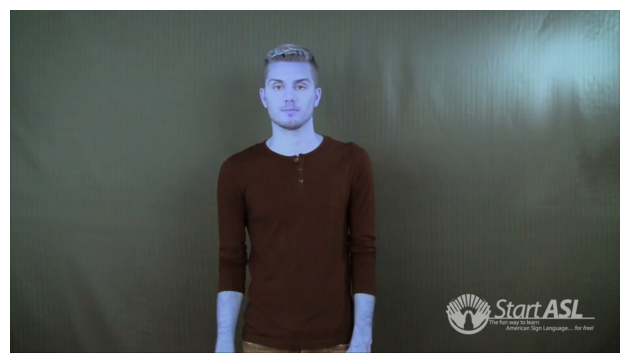

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


In [7]:
ani = ts.show_video(frames)
HTML(ani.to_jshtml())

Apply custom transforms from `code/I3D/videotransforms.py`. This will essentially focus the frames on the hand sign part of the video, as opposed to the entire person

In [8]:
import numbers
from torchvision import transforms
class MyCenterCrop(object):
    """Crops the given seq Images at the center.
    Args:
        size (sequence or int): Desired output size of the crop. If size is an
            int instead of sequence like (h, w), a square crop (size, size) is
            made.
    """

    def __init__(self, size):
        if isinstance(size, numbers.Number):
            self.size = (int(size), int(size))
        else:
            self.size = size

    def __call__(self, imgs):
        """
        Args:
            img (PIL Image): Image to be cropped.
        Returns:
            PIL Image: Cropped image.
        """
        t, h, w, c = imgs.shape
        th, tw = self.size
        i = int(np.round((h - th) / 2.))
        j = int(np.round((w - tw) / 2.))

        return imgs[:, i:i+th, j:j+tw, :]


    def __repr__(self):
        return self.__class__.__name__ + '(size={0})'.format(self.size)

In [9]:
img_transform = transforms.Compose([MyCenterCrop(224)])

In [10]:
transformed_frames = img_transform(frames)

(74, 224, 224, 3)


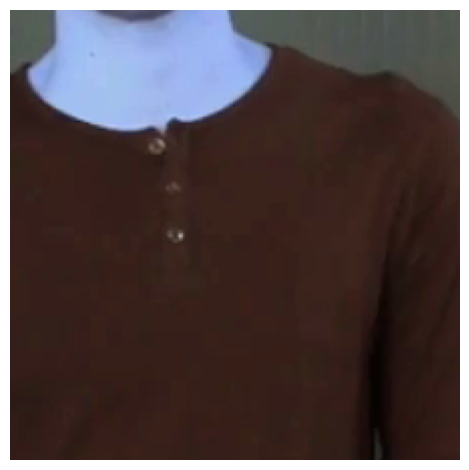

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


In [11]:
ani = ts.show_video(transformed_frames)
HTML(ani.to_jshtml())

Convert to tensor!

In [12]:
tensor_frames = video_to_tensor(transformed_frames)
tensor_frames.shape

torch.Size([3, 74, 224, 224])

NICE! We actually need to create a Dataset and DataLoader first because that will fit the input shape requirements of the model later

In [13]:
dataset = SingleVideoNSLTDataset(video_tensor=tensor_frames, label=label, start_frame=start_frame, num_frames=end_frame, video_name="test")
dataloader = torch.utils.data.DataLoader(dataset, batch_size=1,
                                                 shuffle=False, num_workers=2,
                                                 pin_memory=False)

Ok technically we should be good to go with the model

## Model

Pre-defined inception model, code taken from `code/I3D/pytorch_i3d.py`

In [14]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable

import numpy as np

import os
import sys
from collections import OrderedDict


class MaxPool3dSamePadding(nn.MaxPool3d):
    
    def compute_pad(self, dim, s):
        if s % self.stride[dim] == 0:
            return max(self.kernel_size[dim] - self.stride[dim], 0)
        else:
            return max(self.kernel_size[dim] - (s % self.stride[dim]), 0)

    def forward(self, x):
        # compute 'same' padding
        (batch, channel, t, h, w) = x.size()
        #print t,h,w
        out_t = np.ceil(float(t) / float(self.stride[0]))
        out_h = np.ceil(float(h) / float(self.stride[1]))
        out_w = np.ceil(float(w) / float(self.stride[2]))
        #print out_t, out_h, out_w
        pad_t = self.compute_pad(0, t)
        pad_h = self.compute_pad(1, h)
        pad_w = self.compute_pad(2, w)
        #print pad_t, pad_h, pad_w

        pad_t_f = pad_t // 2
        pad_t_b = pad_t - pad_t_f
        pad_h_f = pad_h // 2
        pad_h_b = pad_h - pad_h_f
        pad_w_f = pad_w // 2
        pad_w_b = pad_w - pad_w_f

        pad = (pad_w_f, pad_w_b, pad_h_f, pad_h_b, pad_t_f, pad_t_b)
        #print x.size()
        #print pad
        x = F.pad(x, pad)
        return super(MaxPool3dSamePadding, self).forward(x)
    

class Unit3D(nn.Module):

    def __init__(self, in_channels,
                 output_channels,
                 kernel_shape=(1, 1, 1),
                 stride=(1, 1, 1),
                 padding=0,
                 activation_fn=F.relu,
                 use_batch_norm=True,
                 use_bias=False,
                 name='unit_3d'):
        
        """Initializes Unit3D module."""
        super(Unit3D, self).__init__()
        
        self._output_channels = output_channels
        self._kernel_shape = kernel_shape
        self._stride = stride
        self._use_batch_norm = use_batch_norm
        self._activation_fn = activation_fn
        self._use_bias = use_bias
        self.name = name
        self.padding = padding
        
        self.conv3d = nn.Conv3d(in_channels=in_channels,
                                out_channels=self._output_channels,
                                kernel_size=self._kernel_shape,
                                stride=self._stride,
                                padding=0, # we always want padding to be 0 here. We will dynamically pad based on input size in forward function
                                bias=self._use_bias)
        
        if self._use_batch_norm:
            self.bn = nn.BatchNorm3d(self._output_channels, eps=0.001, momentum=0.01)

    def compute_pad(self, dim, s):
        if s % self._stride[dim] == 0:
            return max(self._kernel_shape[dim] - self._stride[dim], 0)
        else:
            return max(self._kernel_shape[dim] - (s % self._stride[dim]), 0)

            
    def forward(self, x):
        # compute 'same' padding
        (batch, channel, t, h, w) = x.size()
        #print t,h,w
        out_t = np.ceil(float(t) / float(self._stride[0]))
        out_h = np.ceil(float(h) / float(self._stride[1]))
        out_w = np.ceil(float(w) / float(self._stride[2]))
        #print out_t, out_h, out_w
        pad_t = self.compute_pad(0, t)
        pad_h = self.compute_pad(1, h)
        pad_w = self.compute_pad(2, w)
        #print pad_t, pad_h, pad_w

        pad_t_f = pad_t // 2
        pad_t_b = pad_t - pad_t_f
        pad_h_f = pad_h // 2
        pad_h_b = pad_h - pad_h_f
        pad_w_f = pad_w // 2
        pad_w_b = pad_w - pad_w_f

        pad = (pad_w_f, pad_w_b, pad_h_f, pad_h_b, pad_t_f, pad_t_b)
        #print x.size()
        #print pad
        x = F.pad(x, pad)
        #print x.size()        

        x = self.conv3d(x)
        if self._use_batch_norm:
            x = self.bn(x)
        if self._activation_fn is not None:
            x = self._activation_fn(x)
        return x



class InceptionModule(nn.Module):
    def __init__(self, in_channels, out_channels, name):
        super(InceptionModule, self).__init__()

        self.b0 = Unit3D(in_channels=in_channels, output_channels=out_channels[0], kernel_shape=[1, 1, 1], padding=0,
                         name=name+'/Branch_0/Conv3d_0a_1x1')
        self.b1a = Unit3D(in_channels=in_channels, output_channels=out_channels[1], kernel_shape=[1, 1, 1], padding=0,
                          name=name+'/Branch_1/Conv3d_0a_1x1')
        self.b1b = Unit3D(in_channels=out_channels[1], output_channels=out_channels[2], kernel_shape=[3, 3, 3],
                          name=name+'/Branch_1/Conv3d_0b_3x3')
        self.b2a = Unit3D(in_channels=in_channels, output_channels=out_channels[3], kernel_shape=[1, 1, 1], padding=0,
                          name=name+'/Branch_2/Conv3d_0a_1x1')
        self.b2b = Unit3D(in_channels=out_channels[3], output_channels=out_channels[4], kernel_shape=[3, 3, 3],
                          name=name+'/Branch_2/Conv3d_0b_3x3')
        self.b3a = MaxPool3dSamePadding(kernel_size=[3, 3, 3],
                                stride=(1, 1, 1), padding=0)
        self.b3b = Unit3D(in_channels=in_channels, output_channels=out_channels[5], kernel_shape=[1, 1, 1], padding=0,
                          name=name+'/Branch_3/Conv3d_0b_1x1')
        self.name = name

    def forward(self, x):    
        b0 = self.b0(x)
        b1 = self.b1b(self.b1a(x))
        b2 = self.b2b(self.b2a(x))
        b3 = self.b3b(self.b3a(x))
        return torch.cat([b0,b1,b2,b3], dim=1)


class InceptionI3d(nn.Module):
    """Inception-v1 I3D architecture.
    The model is introduced in:
        Quo Vadis, Action Recognition? A New Model and the Kinetics Dataset
        Joao Carreira, Andrew Zisserman
        https://arxiv.org/pdf/1705.07750v1.pdf.
    See also the Inception architecture, introduced in:
        Going deeper with convolutions
        Christian Szegedy, Wei Liu, Yangqing Jia, Pierre Sermanet, Scott Reed,
        Dragomir Anguelov, Dumitru Erhan, Vincent Vanhoucke, Andrew Rabinovich.
        http://arxiv.org/pdf/1409.4842v1.pdf.
    """

    # Endpoints of the model in order. During construction, all the endpoints up
    # to a designated `final_endpoint` are returned in a dictionary as the
    # second return value.
    VALID_ENDPOINTS = (
        'Conv3d_1a_7x7',
        'MaxPool3d_2a_3x3',
        'Conv3d_2b_1x1',
        'Conv3d_2c_3x3',
        'MaxPool3d_3a_3x3',
        'Mixed_3b',
        'Mixed_3c',
        'MaxPool3d_4a_3x3',
        'Mixed_4b',
        'Mixed_4c',
        'Mixed_4d',
        'Mixed_4e',
        'Mixed_4f',
        'MaxPool3d_5a_2x2',
        'Mixed_5b',
        'Mixed_5c',
        'Logits',
        'Predictions',
    )

    def __init__(self, num_classes=400, spatial_squeeze=True,
                 final_endpoint='Logits', name='inception_i3d', in_channels=3, dropout_keep_prob=0.5):
        """Initializes I3D model instance.
        Args:
          num_classes: The number of outputs in the logit layer (default 400, which
              matches the Kinetics dataset).
          spatial_squeeze: Whether to squeeze the spatial dimensions for the logits
              before returning (default True).
          final_endpoint: The model contains many possible endpoints.
              `final_endpoint` specifies the last endpoint for the model to be built
              up to. In addition to the output at `final_endpoint`, all the outputs
              at endpoints up to `final_endpoint` will also be returned, in a
              dictionary. `final_endpoint` must be one of
              InceptionI3d.VALID_ENDPOINTS (default 'Logits').
          name: A string (optional). The name of this module.
        Raises:
          ValueError: if `final_endpoint` is not recognized.
        """

        if final_endpoint not in self.VALID_ENDPOINTS:
            raise ValueError('Unknown final endpoint %s' % final_endpoint)

        super(InceptionI3d, self).__init__()
        self._num_classes = num_classes
        self._spatial_squeeze = spatial_squeeze
        self._final_endpoint = final_endpoint
        self.logits = None

        if self._final_endpoint not in self.VALID_ENDPOINTS:
            raise ValueError('Unknown final endpoint %s' % self._final_endpoint)

        self.end_points = {}
        end_point = 'Conv3d_1a_7x7'
        self.end_points[end_point] = Unit3D(in_channels=in_channels, output_channels=64, kernel_shape=[7, 7, 7],
                                            stride=(2, 2, 2), padding=(3,3,3),  name=name+end_point)
        if self._final_endpoint == end_point: return
        
        end_point = 'MaxPool3d_2a_3x3'
        self.end_points[end_point] = MaxPool3dSamePadding(kernel_size=[1, 3, 3], stride=(1, 2, 2),
                                                             padding=0)
        if self._final_endpoint == end_point: return
        
        end_point = 'Conv3d_2b_1x1'
        self.end_points[end_point] = Unit3D(in_channels=64, output_channels=64, kernel_shape=[1, 1, 1], padding=0,
                                       name=name+end_point)
        if self._final_endpoint == end_point: return
        
        end_point = 'Conv3d_2c_3x3'
        self.end_points[end_point] = Unit3D(in_channels=64, output_channels=192, kernel_shape=[3, 3, 3], padding=1,
                                       name=name+end_point)
        if self._final_endpoint == end_point: return

        end_point = 'MaxPool3d_3a_3x3'
        self.end_points[end_point] = MaxPool3dSamePadding(kernel_size=[1, 3, 3], stride=(1, 2, 2),
                                                             padding=0)
        if self._final_endpoint == end_point: return
        
        end_point = 'Mixed_3b'
        self.end_points[end_point] = InceptionModule(192, [64,96,128,16,32,32], name+end_point)
        if self._final_endpoint == end_point: return

        end_point = 'Mixed_3c'
        self.end_points[end_point] = InceptionModule(256, [128,128,192,32,96,64], name+end_point)
        if self._final_endpoint == end_point: return

        end_point = 'MaxPool3d_4a_3x3'
        self.end_points[end_point] = MaxPool3dSamePadding(kernel_size=[3, 3, 3], stride=(2, 2, 2),
                                                             padding=0)
        if self._final_endpoint == end_point: return

        end_point = 'Mixed_4b'
        self.end_points[end_point] = InceptionModule(128+192+96+64, [192,96,208,16,48,64], name+end_point)
        if self._final_endpoint == end_point: return

        end_point = 'Mixed_4c'
        self.end_points[end_point] = InceptionModule(192+208+48+64, [160,112,224,24,64,64], name+end_point)
        if self._final_endpoint == end_point: return

        end_point = 'Mixed_4d'
        self.end_points[end_point] = InceptionModule(160+224+64+64, [128,128,256,24,64,64], name+end_point)
        if self._final_endpoint == end_point: return

        end_point = 'Mixed_4e'
        self.end_points[end_point] = InceptionModule(128+256+64+64, [112,144,288,32,64,64], name+end_point)
        if self._final_endpoint == end_point: return

        end_point = 'Mixed_4f'
        self.end_points[end_point] = InceptionModule(112+288+64+64, [256,160,320,32,128,128], name+end_point)
        if self._final_endpoint == end_point: return

        end_point = 'MaxPool3d_5a_2x2'
        self.end_points[end_point] = MaxPool3dSamePadding(kernel_size=[2, 2, 2], stride=(2, 2, 2),
                                                             padding=0)
        if self._final_endpoint == end_point: return

        end_point = 'Mixed_5b'
        self.end_points[end_point] = InceptionModule(256+320+128+128, [256,160,320,32,128,128], name+end_point)
        if self._final_endpoint == end_point: return

        end_point = 'Mixed_5c'
        self.end_points[end_point] = InceptionModule(256+320+128+128, [384,192,384,48,128,128], name+end_point)
        if self._final_endpoint == end_point: return

        end_point = 'Logits'
        self.avg_pool = nn.AvgPool3d(kernel_size=[2, 7, 7],
                                     stride=(1, 1, 1))
        self.dropout = nn.Dropout(dropout_keep_prob)
        self.logits  = Unit3D(in_channels=384+384+128+128, output_channels=self._num_classes,
                             kernel_shape=[1, 1, 1],
                             padding=0,
                             activation_fn=None,
                             use_batch_norm=False,
                             use_bias=True,
                             name='logits')

        self.build()


    def replace_logits(self, num_classes):
        self._num_classes = num_classes
        self.logits = Unit3D(in_channels=384+384+128+128, output_channels=self._num_classes,
                             kernel_shape=[1, 1, 1],
                             padding=0,
                             activation_fn=None,
                             use_batch_norm=False,
                             use_bias=True,
                             name='logits')

    def build(self):
        for k in self.end_points.keys():
            self.add_module(k, self.end_points[k])
        
    def forward(self, x, pretrained=False, n_tune_layers=-1):
        if pretrained:
            assert n_tune_layers >= 0

            freeze_endpoints = self.VALID_ENDPOINTS[:-n_tune_layers]
            tune_endpoints = self.VALID_ENDPOINTS[-n_tune_layers:]
        else:
            freeze_endpoints = []
            tune_endpoints = self.VALID_ENDPOINTS

        # backbone, no gradient part
        with torch.no_grad():
            for end_point in freeze_endpoints:
                if end_point in self.end_points:
                    x = self._modules[end_point](x) # use _modules to work with dataparallel

        # backbone, gradient part
        for end_point in tune_endpoints:
            if end_point in self.end_points:
                x = self._modules[end_point](x) # use _modules to work with dataparallel

        # head
        x = self.logits(self.dropout(self.avg_pool(x)))
        if self._spatial_squeeze:
            logits = x.squeeze(3).squeeze(3)
        # logits is batch X time X classes, which is what we want to work with
        return logits
        

    def extract_features(self, x):
        for end_point in self.VALID_ENDPOINTS:
            if end_point in self.end_points:
                x = self._modules[end_point](x)
        return self.avg_pool(x)

We'll do a step-by-step inference run, based on the `run()` function in `code/I3D/test_i3d.py`

In [15]:
i3d = InceptionI3d(400, in_channels=3)

In [16]:
# We'll use the weights from the general pre-trained inception model, then the weights for the fine tuned one on ASL
id3_pretrained_weights_path = "model_weights/weights/rgb_imagenet.pt"
wlasl_pretrained_weights_path = "model_weights/archived/asl100/FINAL_nslt_100_iters=896_top1=65.89_top5=84.11_top10=89.92.pt"
num_classes = 100

In [17]:
# Load the general inception model weights
i3d.load_state_dict(torch.load(id3_pretrained_weights_path))

<All keys matched successfully>

In [18]:
# Adapt the final layer for the number of classes we expect
i3d.replace_logits(num_classes)

In [19]:
# Load the weights for the fine-tuned model on ASL
i3d.load_state_dict(torch.load(wlasl_pretrained_weights_path))

<All keys matched successfully>

In [20]:
# Move to GPU
i3d.cuda()

InceptionI3d(
  (avg_pool): AvgPool3d(kernel_size=[2, 7, 7], stride=(1, 1, 1), padding=0)
  (dropout): Dropout(p=0.5, inplace=False)
  (logits): Unit3D(
    (conv3d): Conv3d(1024, 100, kernel_size=(1, 1, 1), stride=(1, 1, 1))
  )
  (Conv3d_1a_7x7): Unit3D(
    (conv3d): Conv3d(3, 64, kernel_size=(7, 7, 7), stride=(2, 2, 2), bias=False)
    (bn): BatchNorm3d(64, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
  )
  (MaxPool3d_2a_3x3): MaxPool3dSamePadding(kernel_size=[1, 3, 3], stride=(1, 2, 2), padding=0, dilation=1, ceil_mode=False)
  (Conv3d_2b_1x1): Unit3D(
    (conv3d): Conv3d(64, 64, kernel_size=(1, 1, 1), stride=(1, 1, 1), bias=False)
    (bn): BatchNorm3d(64, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
  )
  (Conv3d_2c_3x3): Unit3D(
    (conv3d): Conv3d(64, 192, kernel_size=(3, 3, 3), stride=(1, 1, 1), bias=False)
    (bn): BatchNorm3d(192, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
  )
  (MaxPool3d_3a_3x3): MaxPool3dSa

In [21]:
# Add data parallelism layer (but this is not actually that useful here since we're only using 1 example)
i3d = nn.DataParallel(i3d)

In [22]:
# Put model in inference mode
i3d.eval()

DataParallel(
  (module): InceptionI3d(
    (avg_pool): AvgPool3d(kernel_size=[2, 7, 7], stride=(1, 1, 1), padding=0)
    (dropout): Dropout(p=0.5, inplace=False)
    (logits): Unit3D(
      (conv3d): Conv3d(1024, 100, kernel_size=(1, 1, 1), stride=(1, 1, 1))
    )
    (Conv3d_1a_7x7): Unit3D(
      (conv3d): Conv3d(3, 64, kernel_size=(7, 7, 7), stride=(2, 2, 2), bias=False)
      (bn): BatchNorm3d(64, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
    )
    (MaxPool3d_2a_3x3): MaxPool3dSamePadding(kernel_size=[1, 3, 3], stride=(1, 2, 2), padding=0, dilation=1, ceil_mode=False)
    (Conv3d_2b_1x1): Unit3D(
      (conv3d): Conv3d(64, 64, kernel_size=(1, 1, 1), stride=(1, 1, 1), bias=False)
      (bn): BatchNorm3d(64, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
    )
    (Conv3d_2c_3x3): Unit3D(
      (conv3d): Conv3d(64, 192, kernel_size=(3, 3, 3), stride=(1, 1, 1), bias=False)
      (bn): BatchNorm3d(192, eps=0.001, momentum=0.01, affine=True, tra

## Inference

In [24]:
# Inference time! Get the logits for the single video example
for data in dataloader:
    inputs, labels, video_id = data 
    per_frame_logits = i3d(inputs)

# Batch size, number of classes, unclear what the 3rd number/dimension is here?
per_frame_logits.shape

torch.Size([1, 100, 9])

In [25]:
predictions = torch.max(per_frame_logits, dim=2)[0]
predictions, predictions.shape

(tensor([[-6.8943, -6.9719, -6.1586, -2.2624, -7.4136, -6.5206, -7.2159, -5.4910,
          -5.7481, -7.0237, -5.8731, -4.7742, -2.4911, -6.2145, -4.9319, -7.1503,
          -4.7263, -6.3560, -4.7752, -5.8709, -5.9075, -4.3857, -6.0193, -6.6999,
          -5.5103, -6.4186, -5.9696, -6.5745, -6.8308, -6.7264, -5.8903, -6.1786,
          -3.5448, -5.3367, -4.8103, -6.4961, -6.3845, -6.0842, -3.7555, -3.8316,
          -6.5436, -6.7520, -3.6641, -5.2733, -4.8289, -6.8512, -6.8461, -7.3165,
          -2.9454, -6.6926, -5.6876, -5.4813, -6.8194, -4.8984, -5.4714, -5.2917,
          -6.4157, -6.7365, -6.2776, -5.4314, -5.8447, -5.3108, -6.5722, -4.7191,
          -5.8567, -3.6857, -4.4332, -5.8521, -6.4388, -5.7078, -6.4715, -5.4717,
          -5.2596, -7.0225, -6.0642, -5.1190, -5.7356, -6.1026, -5.5462, -5.4921,
          -6.2543, -6.0233, -5.8630, -5.8564, -5.9048, -5.4375, -4.7129, -5.4633,
          -5.5021, -5.3746, -6.8100, -5.4746, -5.0065, -5.5687, -7.2944, -2.4071,
          -6.321

In [34]:
# Sort predictions in a descending order of relevance - the top prediction is at the end
# This is an array of indices!
out_labels = np.argsort(predictions.cpu().detach().numpy()[0])
out_labels

array([ 4, 47, 94,  6, 15,  9, 73,  1,  0, 45, 46, 28, 52, 90, 41, 57, 29,
       23, 49, 27, 62, 40,  5, 35, 70, 68, 25, 56, 36, 17, 96, 58, 80, 13,
       31,  2, 77, 37, 74, 81, 22, 97, 26, 20, 84, 30, 10, 19, 82, 64, 83,
       67, 60,  8, 76, 69, 50, 93, 78, 24, 88, 79,  7, 51, 91, 71, 54, 87,
       85, 59, 99, 89, 33, 61, 55, 43, 72, 75, 92, 14, 53, 44, 34, 18, 11,
       16, 63, 86, 66, 21, 39, 38, 65, 42, 32, 98, 48, 12, 95,  3])

In [41]:
# Is the correct label in the top 5 labels?
labels[0].item() in out_labels[-5:]

True

In [42]:
# Is the correct label in the top 10 labels?
labels[0].item() in out_labels[-10:]

True

In [43]:
# Is the correct label the top predicted label?
labels[0].item() == torch.argmax(predictions[0]).item()

True